<a href="https://colab.research.google.com/github/ryan1w/deepmind-research/blob/master/Nuclei_Seg_Yolov9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"username","key":"key"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

Dataset URL: https://www.kaggle.com/datasets/ipateam/nuinsseg
License(s): Attribution 4.0 International (CC BY 4.0)
 99% 1.50G/1.52G [00:09<00:00, 136MB/s]
100% 1.52G/1.52G [00:09<00:00, 167MB/s]


In [7]:
!mkdir Nuclei-Instance-Dataset
%cd Nuclei-Instance-Dataset
!kaggle datasets download -d ipateam/nuinsseg
!unzip nuinsseg.zip
!pwd

mkdir: cannot create directory ‘Nuclei-Instance-Dataset’: File exists
/content/Nuclei-Instance-Dataset


In [14]:
!pip install -q ultralytics pycocotools

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 40.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 67.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 86.5 MB/s eta 0:00:00


In [15]:
import os
import copy
import random
import json
import yaml
import glob
import cv2
import numpy as np
import time
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import requests
from   zipfile import ZipFile
import argparse
from PIL import Image
import PIL.Image
import shutil
from IPython.display import Image
from sklearn.model_selection import train_test_split

import torch
import torch.utils.data
from torch import nn
import torchvision
from torchvision import transforms as T

from ultralytics import YOLO
from pycocotools import mask as coco_mask
from pycocotools.coco import COCO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [16]:
def set_seeds():
    # fix random seeds
    SEED_VALUE = 42

    random.seed(SEED_VALUE)
    np.random.seed(SEED_VALUE)
    torch.manual_seed(SEED_VALUE)

    if torch.cuda.is_available():
        torch.cuda.manual_seed(SEED_VALUE)
        torch.cuda.manual_seed_all(SEED_VALUE)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = True
set_seeds()

In [27]:
def prune_subdirectories(base_dir,keep_dirs):
    #Iterate through each subdirs in base dir
    for root_dir in os.listdir(base_dir):
        root_path = os.path.join(base_dir,root_dir)
        if os.path.isdir(root_path):
          #  print(f"Processing: {root_path}")
           #List all subdirs inside the current root dir
           for sub_dir in os.listdir(root_path):
               sub_path = os.path.join(root_path, sub_dir)
               #If the subdirectory isn't in the keep list, delete it
               if os.path.isdir(sub_path) and sub_dir not in keep_dirs:
                  # print(f"Deleting: {sub_path}")
                  shutil.rmtree(sub_path)
               elif os.path.isdir(sub_path):
                  # print(f"Keeping: {sub_path}")
                  pass

base_directory = "./Nuclei-Instance-Dataset"
directories_to_keep = ['tissue images', 'mask binary witthout border', 'label masks modify']

prune_subdirectories(base_directory,directories_to_keep)

In [28]:
def get_image_mask_pairs(data_dir):
    image_paths = []
    mask_paths = []

    for root,_,files in os.walk(data_dir):
        if 'tissue images' in root:
            for file in files:
                if file.endswith('.png'):
                    image_paths.append(os.path.join(root,file))
                    mask_paths.append(os.path.join(root.replace('tissue images','label masks modify'), file.replace('.png','.tif')))
    return image_paths, mask_paths

In [29]:
def mask_to_polygons(mask,epsilon=1.0):
    contours,_ = cv2.findContours(mask,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    polygons = []
    for contour in contours:
        if len(contour) > 2:
           poly = contour.reshape(-1).tolist()
           if len(poly) > 4: #Ensures valid polygon
              polygons.append(poly)
    return polygons

In [30]:
def process_data(image_paths, mask_paths, output_images_dir, output_labels_dir):
    annotations = []
    images = []
    image_id = 0
    ann_id = 0

    for img_path, mask_path in zip(image_paths, mask_paths):
        image_id += 1
        img = cv2.imread(img_path)
        mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
        shutil.copy(img_path, os.path.join(output_images_dir, os.path.basename(img_path)))

        # Add image to the list
        images.append({
            "id": image_id,
            "file_name": os.path.basename(img_path),
            "height": img.shape[0],
            "width": img.shape[1]
        })

        unique_values = np.unique(mask)
        for value in unique_values:
            if value == 0:  # Ignore background
                continue

            object_mask = (mask == value).astype(np.uint8) * 255
            polygons = mask_to_polygons(object_mask)

            for poly in polygons:
                ann_id += 1
                annotations.append({

                    "image_id": image_id,
                    "category_id": 1,  # Only one category: Nuclei
                    "segmentation": [poly],

                })

    coco_input = {
        "images": images,
        "annotations": annotations,
        "categories": [{"id": 1, "name": "Nuclei"}]
    }

    # Convert COCO-like dictionary to YOLO format
    for img_info in coco_input["images"]:
        img_id = img_info["id"]
        img_ann = [ann for ann in coco_input["annotations"] if ann["image_id"] == img_id]
        img_w, img_h = img_info["width"], img_info["height"]

        if img_ann == []:
            continue

        with open(os.path.join(output_labels_dir, os.path.splitext(img_info["file_name"])[0] + '.txt'), 'w') as file_object:
            for ann in img_ann:
                current_category = ann['category_id'] - 1
                polygon = ann['segmentation'][0]
                normalized_polygon = [format(coord / img_w if i % 2 == 0 else coord / img_h, '.6f') for i, coord in enumerate(polygon)]
                file_object.write(f"{current_category} " + " ".join(normalized_polygon) + "\n")

In [31]:
def create_yaml(output_yaml_path, train_images_dir, val_images_dir, nc=1):
    # Assuming all categories are the same and there is only one class, 'Nuclei'
    names = ['Nuclei']

    # Create a dictionary with the required content
    yaml_data = {
        'names': names,
        'nc': nc,  # Number of classes
        'train': train_images_dir,
        'val': val_images_dir,
        'test': ' '

    }

    # Write the dictionary to a YAML file
    with open(output_yaml_path, 'w') as file:
        yaml.dump(yaml_data, file, default_flow_style=False)

In [32]:
def yolo_dataset_preparation():
    data_dir = 'Nuclei-Instance-Dataset'
    output_dir = 'yolov9e_1024_dataset'

    # Define the paths for the images and labels for training and validation
    train_images_dir = os.path.join(output_dir, 'train', 'images')
    val_images_dir = os.path.join(output_dir, 'val', 'images')
    train_labels_dir = os.path.join(output_dir, 'train', 'labels')
    val_labels_dir = os.path.join(output_dir, 'val', 'labels')

    # Create the output directories if they do not exist
    os.makedirs(train_images_dir, exist_ok=True)
    os.makedirs(val_images_dir, exist_ok=True)
    os.makedirs(train_labels_dir, exist_ok=True)
    os.makedirs(val_labels_dir, exist_ok=True)

    # Get image and mask paths
    image_paths, mask_paths = get_image_mask_pairs(data_dir)

    # Split data into train and val
    train_img_paths, val_img_paths, train_mask_paths, val_mask_paths = train_test_split(image_paths, mask_paths, test_size=0.2, random_state=42)

    # Process and save the data in YOLO format for training and validation
    process_data(train_img_paths, train_mask_paths, train_images_dir, train_labels_dir)
    process_data(val_img_paths, val_mask_paths, val_images_dir, val_labels_dir)

    # Assume create_yaml function is defined elsewhere and set appropriate paths for the YAML file
    output_yaml_path = os.path.join(output_dir, 'data.yaml')
    train_path = os.path.join('train', 'images')
    val_path = os.path.join('val', 'images')
    create_yaml(output_yaml_path, train_path, val_path)

yolo_dataset_preparation()

In [33]:
model = YOLO("yolov9e-seg.yaml")#build a model from YAML
model = YOLO("yolov9e-seg.pt") #Transfer the weights from a pretrained model (recommended for training)

100%|██████████| 117M/117M [00:04<00:00, 28.4MB/s]


In [34]:
%cat yolov9e_1024_dataset/data.yaml

names:
- Nuclei
nc: 1
test: ' '
train: train/images
val: val/images


In [35]:
with open("yolov9e_1024_dataset/data.yaml",'r') as stream:
     num_classes = str(yaml.safe_load(stream)['nc'])

In [36]:
#Define a project --> Destination directory for all results
project = "yolov9e_1024_dataset/results"
#Define subdirectory for this specific training
name = "70_epochs-"

In [37]:
ABS_PATH = os.getcwd()

'/content'

In [ ]:
results = model.train(
    data = os.path.join(ABS_PATH, "yolov9e_1024_dataset/data.yaml"),
    project = project,
    name = name,
    epochs = 70,
    patience = 0 , #setting patience=0 to disable early stopping,
    batch = 2,
    imgsz=512
)

Ultralytics 8.3.168 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=2, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/yolov9e_1024_dataset/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=70, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=500, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov9e-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=70_epochs-, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=0, perspective=0.0, plots=True, pose

100%|██████████| 755k/755k [00:00<00:00, 31.7MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1         0  torch.nn.modules.linear.Identity             []                            
  1                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  2                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  3                  -1  1    252160  ultralytics.nn.modules.block.RepNCSPELAN4    [128, 256, 128, 64, 2]        
  4                  -1  1    164352  ultralytics.nn.modules.block.ADown           [256, 256]                    


  5                  -1  1   1004032  ultralytics.nn.modules.block.RepNCSPELAN4    [256, 512, 256, 128, 2]       
  6                  -1  1    656384  ultralytics.nn.modules.block.ADown           [512, 512]                    
  7                  -1  1   4006912  ultralytics.nn.modules.block.RepNCSPELAN4    [512, 1024, 512, 256, 2]      
  8                  -1  1   2623488  ultralytics.nn.modules.block.ADown           [1024, 1024]                  
  9                  -1  1   4269056  ultralytics.nn.modules.block.RepNCSPELAN4    [1024, 1024, 512, 256, 2]     
 10                   1  1      4160  ultralytics.nn.modules.block.CBLinear        [64, [64]]                    
 11                   3  1     49344  ultralytics.nn.modules.block.CBLinear        [256, [64, 128]]              
 12                   5  1    229824  ultralytics.nn.modules.block.CBLinear        [512, [64, 128, 256]]         
 13                   7  1    984000  ultralytics.nn.modules.block.CBLinear        [1024

100%|██████████| 5.35M/5.35M [00:00<00:00, 126MB/s]


AMP: checks passed ✅
WARNING ⚠️ imgsz=[500] must be multiple of max stride 32, updating to [512]
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2810.9±731.5 MB/s, size: 415.1 KB)


train: Scanning /content/yolov9e_1024_dataset/train/labels... 532 images, 0 backgrounds, 0 corrupt: 100%|██████████| 532/532 [00:01<00:00, 361.62it/s]


train: New cache created: /content/yolov9e_1024_dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2320.3±1540.4 MB/s, size: 404.1 KB)


val: Scanning /content/yolov9e_1024_dataset/val/labels... 133 images, 0 backgrounds, 0 corrupt: 100%|██████████| 133/133 [00:01<00:00, 101.28it/s]

val: New cache created: /content/yolov9e_1024_dataset/val/labels.cache


Plotting labels to yolov9e_1024_dataset/results/70_epochs-/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 307 weight(decay=0.0), 323 weight(decay=0.0005), 322 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to yolov9e_1024_dataset/results/70_epochs-
Starting training for 70 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/70      4.04G      1.873      2.863      1.297      1.352        136        512: 100%|██████████| 266/266 [02:14<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:08<00:00,  4.19it/s]

                   all        133       6312      0.198       0.29       0.12     0.0617      0.197      0.283      0.111      0.048



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/70      4.03G      1.869       2.76      1.216       1.33         63        512: 100%|██████████| 266/266 [01:57<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:07<00:00,  4.49it/s]


                   all        133       6312       0.68      0.606      0.661      0.323      0.676      0.594      0.648      0.279

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/70      4.54G      1.905      2.761      1.228      1.344        109        512: 100%|██████████| 266/266 [01:57<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:06<00:00,  4.91it/s]

                   all        133       6312      0.704      0.505      0.586      0.284      0.684      0.476      0.543      0.219



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/70      4.81G      1.869       2.74      1.127      1.312        147        512: 100%|██████████| 266/266 [01:55<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:07<00:00,  4.59it/s]


                   all        133       6312      0.768      0.653      0.737      0.391       0.76      0.638      0.718      0.339

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/70      5.21G      1.824      2.655      1.093      1.294         87        512: 100%|██████████| 266/266 [01:56<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:07<00:00,  4.60it/s]


                   all        133       6312      0.773      0.651      0.749      0.373      0.762      0.606        0.7      0.293

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/70      5.52G       1.75      2.589      1.112      1.273        286        512: 100%|██████████| 266/266 [01:56<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:06<00:00,  5.26it/s]

                   all        133       6312      0.776      0.663      0.755      0.399      0.761      0.643      0.728      0.338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/70       5.9G      1.776      2.566       1.07      1.276        115        512: 100%|██████████| 266/266 [01:55<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:07<00:00,  4.74it/s]

                   all        133       6312      0.735      0.664      0.721      0.372       0.73      0.657      0.714      0.342



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/70       6.3G      1.773      2.571      1.083      1.276        179        512: 100%|██████████| 266/266 [01:58<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 34/34 [00:07<00:00,  4.52it/s]


                   all        133       6312      0.778      0.658      0.749      0.373      0.758      0.633      0.714      0.315

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/70      6.65G      1.814      2.693      1.075      1.287         50        512:  55%|█████▍    | 146/266 [01:03<00:50,  2.39it/s]

In [ ]:
inference_model = YOLO('yolov9e_1024_dataset/results/70_epochs-5/weights/best.pt')

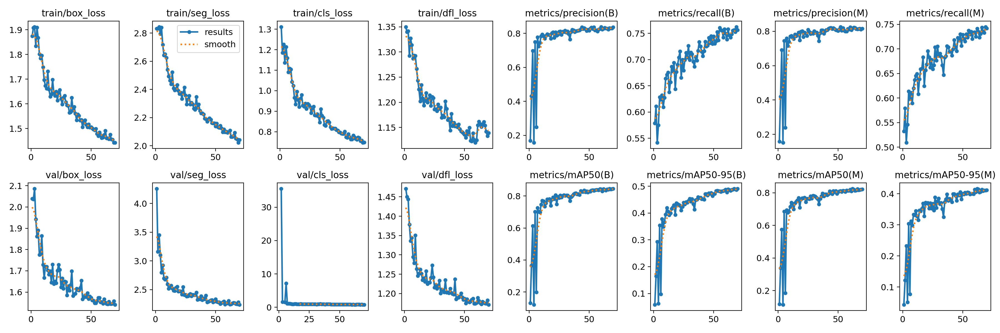

In [ ]:
Image("yolov9e_1024_dataset/results/70_epochs-5/results.png")


image 1/1 /content/yolov9e_1024_dataset/val/images/human_brain_5.png: 512x512 2 Nucleis, 95.0ms
Speed: 1.4ms preprocess, 95.0ms inference, 9.1ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


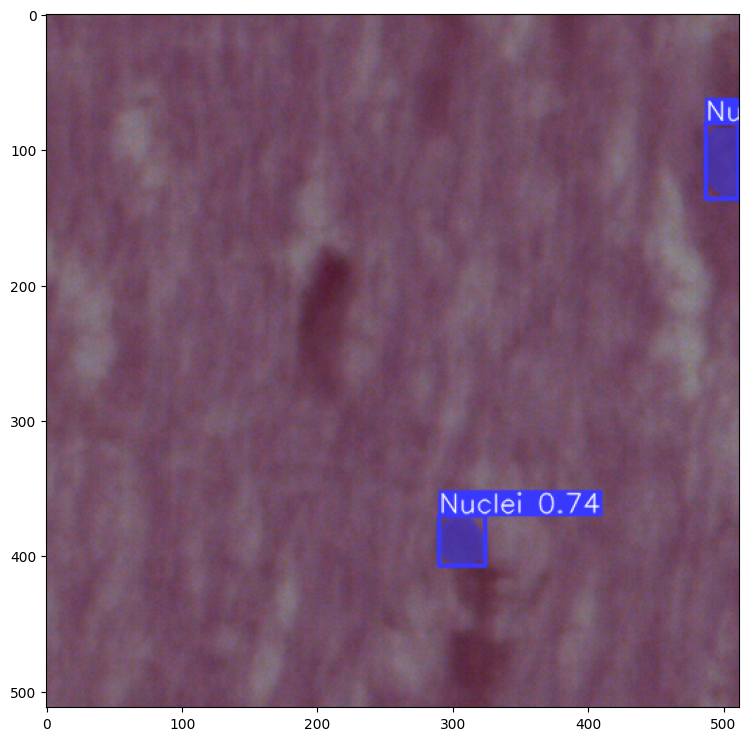

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_brain_5.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_brain_2.png: 512x512 2 Nucleis, 92.1ms
Speed: 1.7ms preprocess, 92.1ms inference, 3.8ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


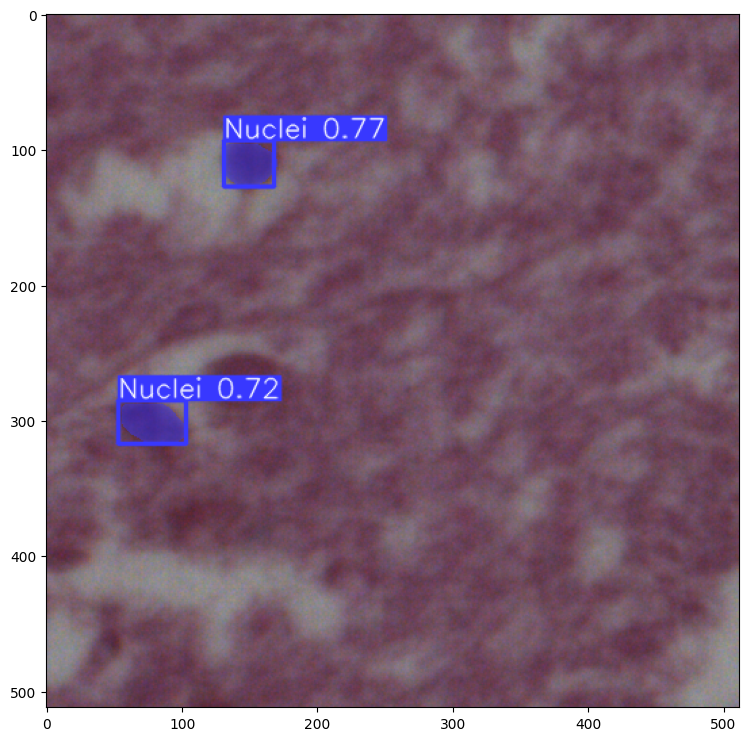

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_brain_2.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_bladder_06.png: 512x512 4 Nucleis, 109.1ms
Speed: 2.1ms preprocess, 109.1ms inference, 9.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


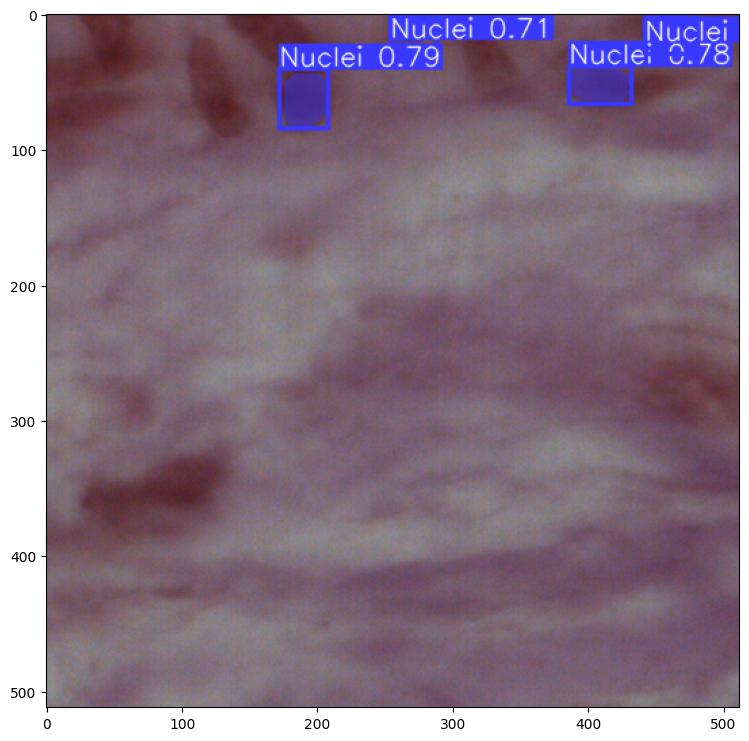

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_bladder_06.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_cardia_7.png: 512x512 8 Nucleis, 109.0ms
Speed: 1.6ms preprocess, 109.0ms inference, 7.6ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


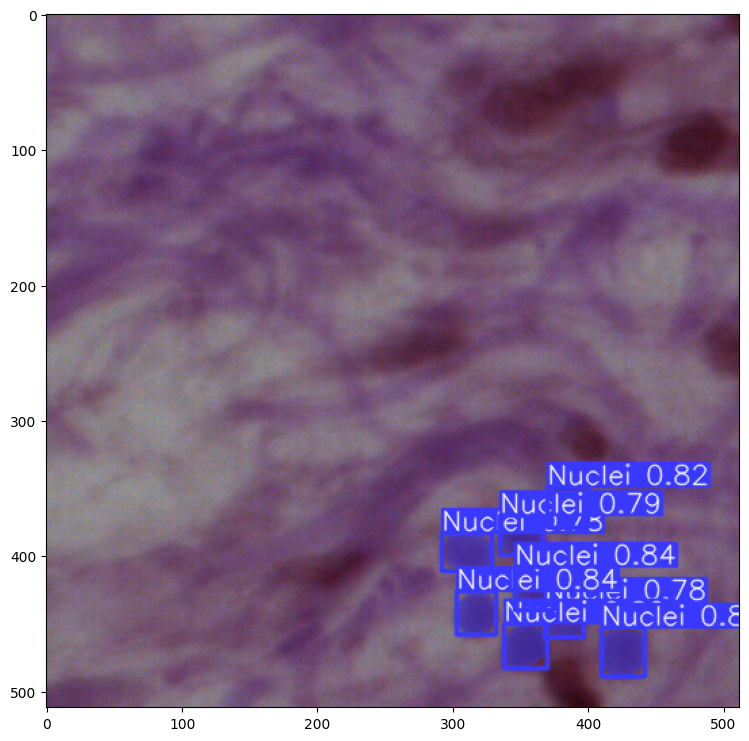

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_cardia_7.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_cerebellum_6.png: 512x512 52 Nucleis, 200.2ms
Speed: 1.6ms preprocess, 200.2ms inference, 16.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


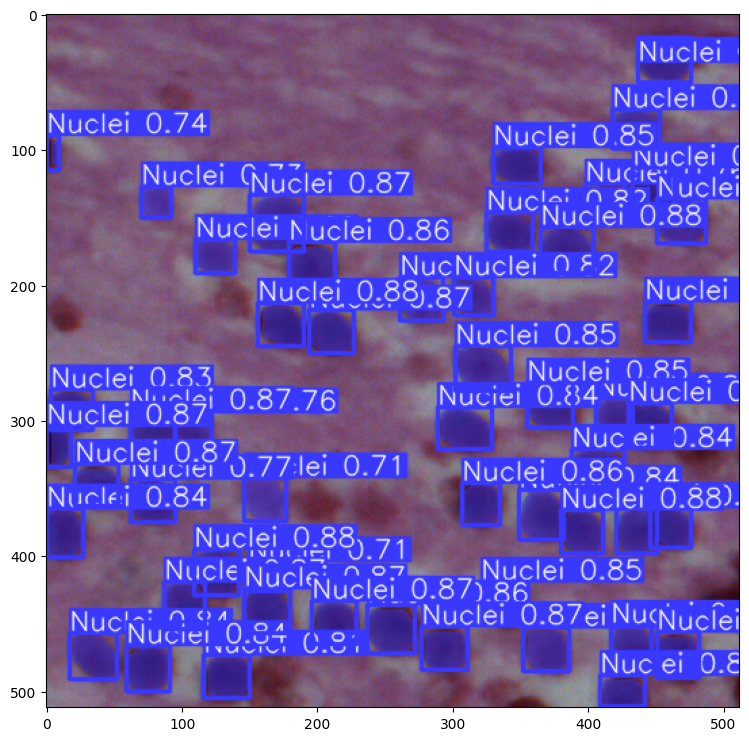

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_cerebellum_6.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_epiglottis_11.png: 512x512 2 Nucleis, 121.7ms
Speed: 8.4ms preprocess, 121.7ms inference, 9.8ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


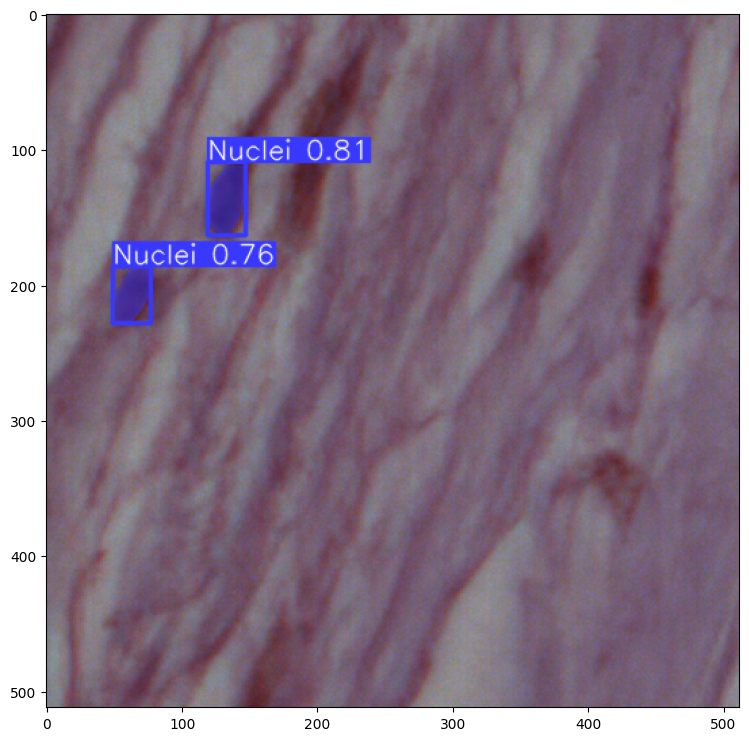

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_epiglottis_11.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_jejunum_02.png: 512x512 28 Nucleis, 84.2ms
Speed: 1.8ms preprocess, 84.2ms inference, 10.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


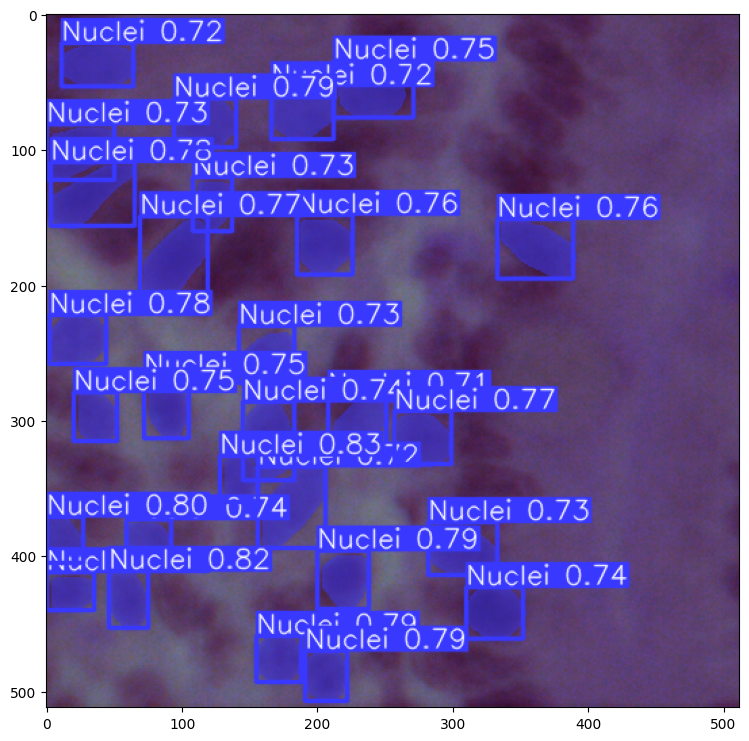

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_jejunum_02.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_kidney_02.png: 512x512 31 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 12.5ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


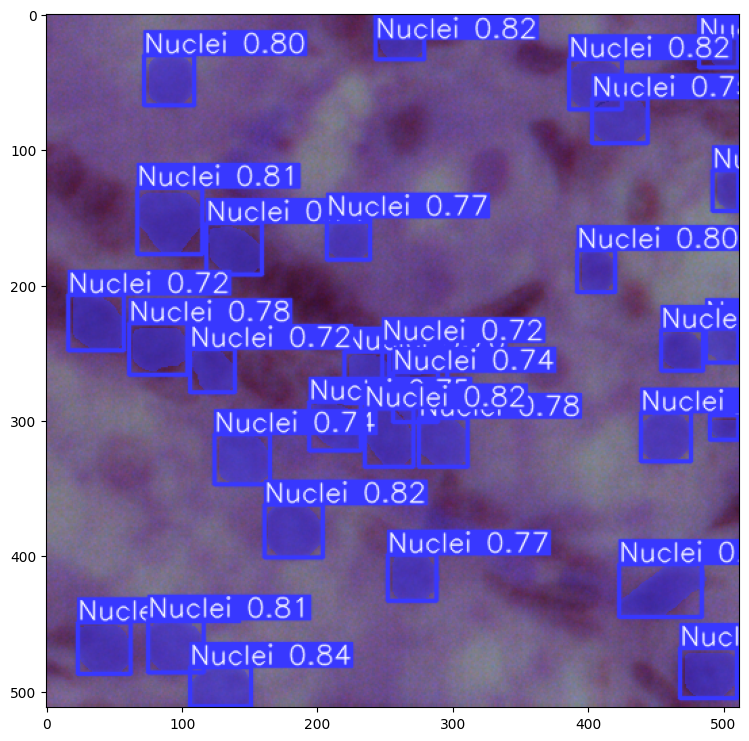

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_kidney_02.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_liver_29.png: 512x512 5 Nucleis, 85.5ms
Speed: 1.8ms preprocess, 85.5ms inference, 6.4ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


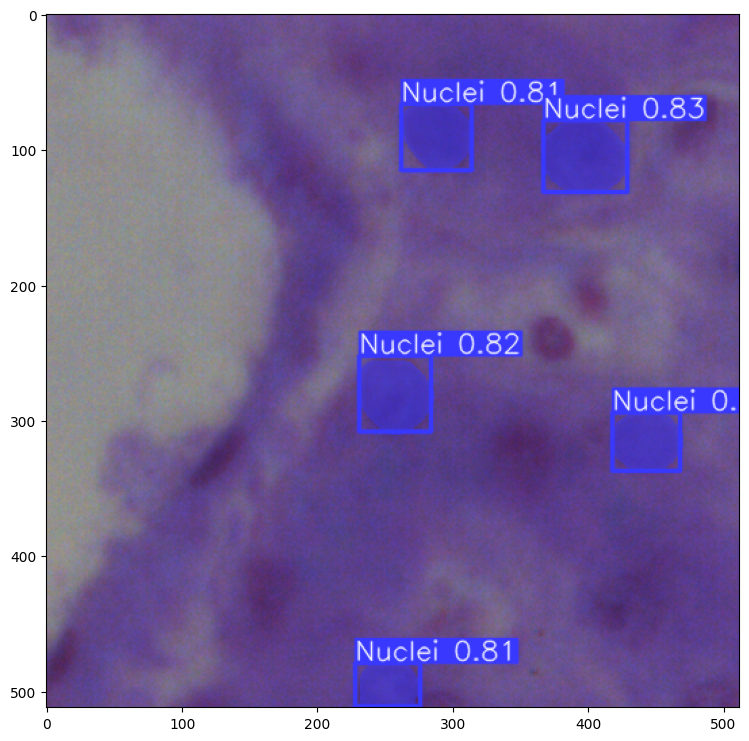

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_liver_29.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_lung_6.png: 512x512 7 Nucleis, 87.5ms
Speed: 1.7ms preprocess, 87.5ms inference, 7.1ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


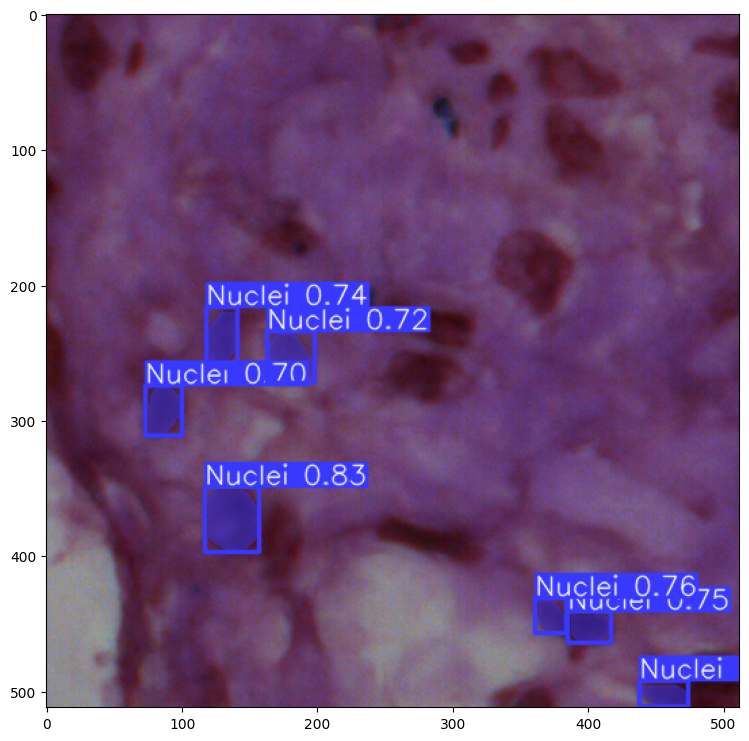

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_lung_6.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_melanoma_01.png: 512x512 12 Nucleis, 205.6ms
Speed: 1.7ms preprocess, 205.6ms inference, 49.5ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


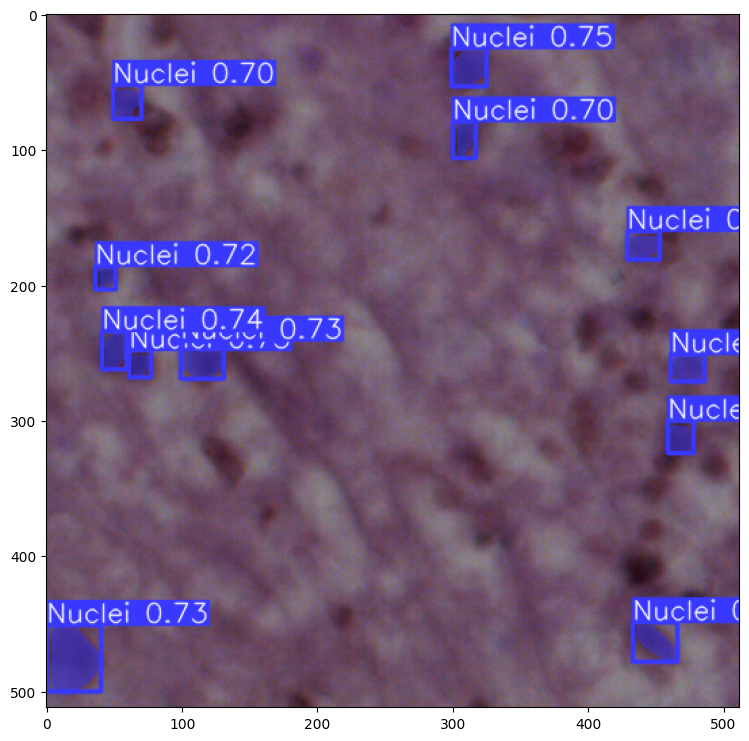

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_melanoma_01.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_oesophagus_07.png: 512x512 26 Nucleis, 90.7ms
Speed: 1.7ms preprocess, 90.7ms inference, 9.3ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


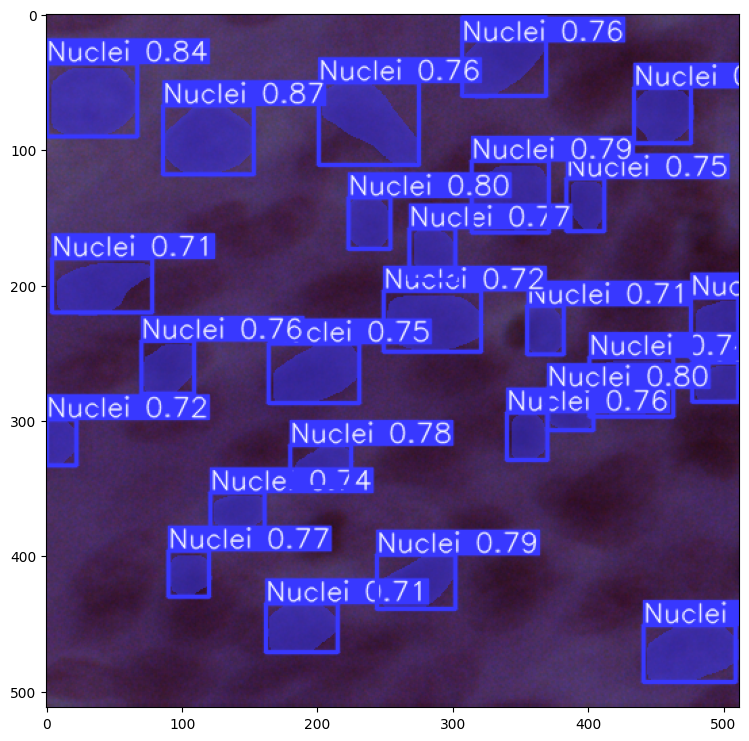

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_oesophagus_07.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_muscle_6.png: 512x512 1 Nuclei, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 4.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


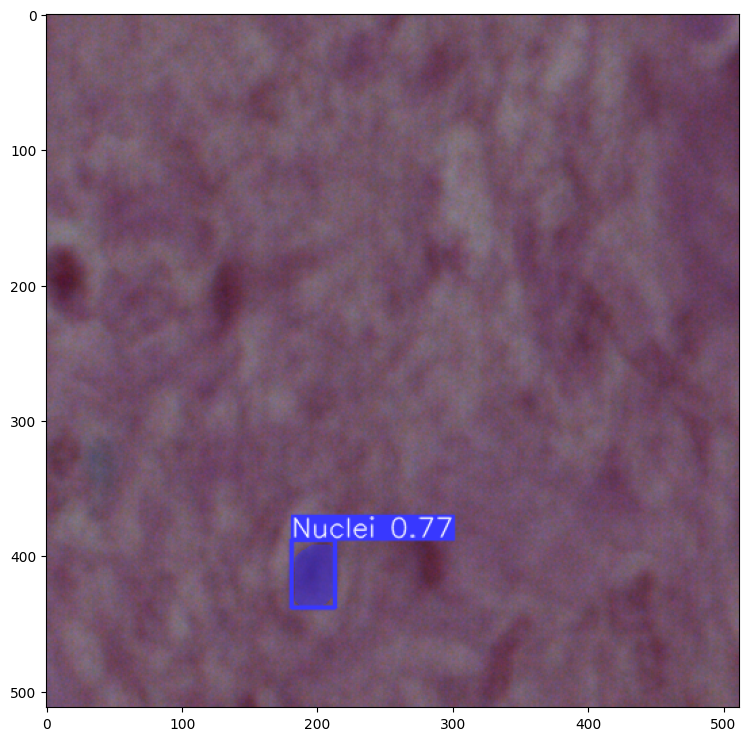

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_muscle_6.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_pancreas_11.png: 512x512 26 Nucleis, 79.4ms
Speed: 1.3ms preprocess, 79.4ms inference, 8.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


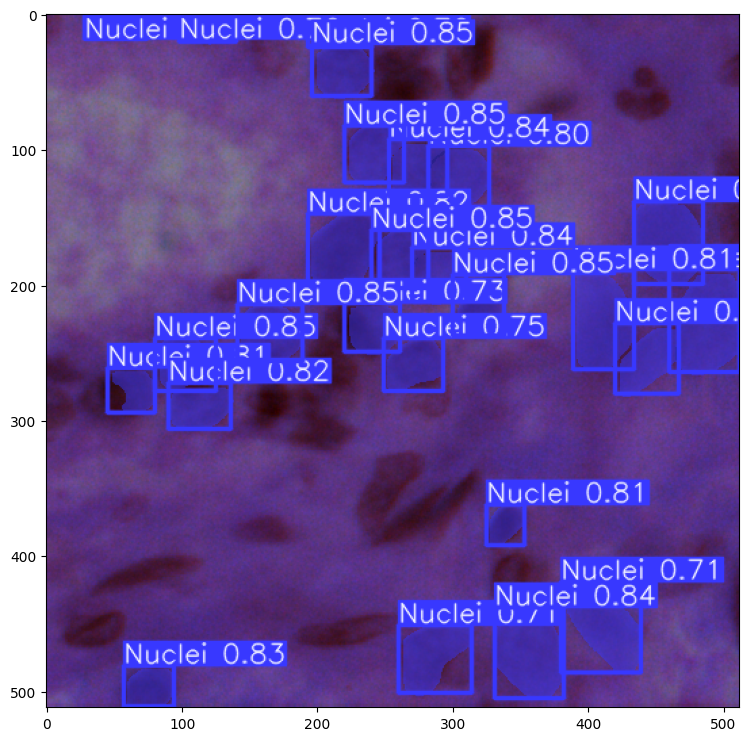

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_pancreas_11.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_salivory_24.png: 512x512 26 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 8.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


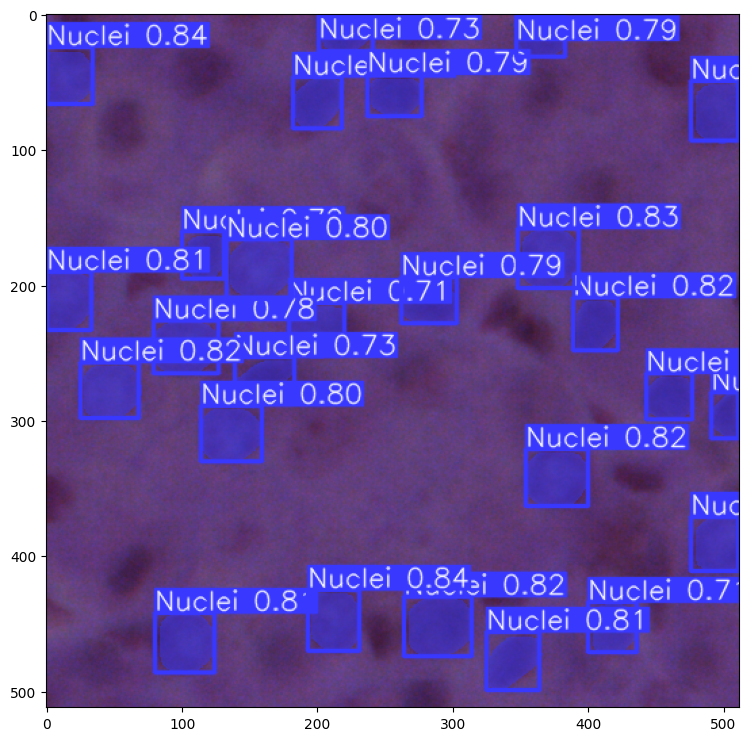

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_salivory_24.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_testis_10.png: 512x512 5 Nucleis, 175.9ms
Speed: 3.2ms preprocess, 175.9ms inference, 7.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


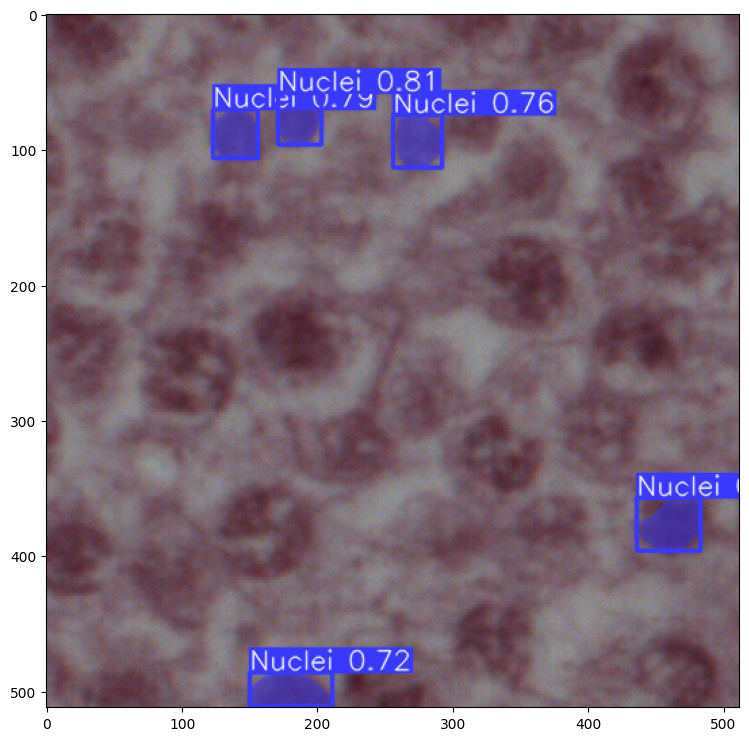

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_testis_10.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_peritoneum_3.png: 512x512 12 Nucleis, 79.5ms
Speed: 1.4ms preprocess, 79.5ms inference, 5.5ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


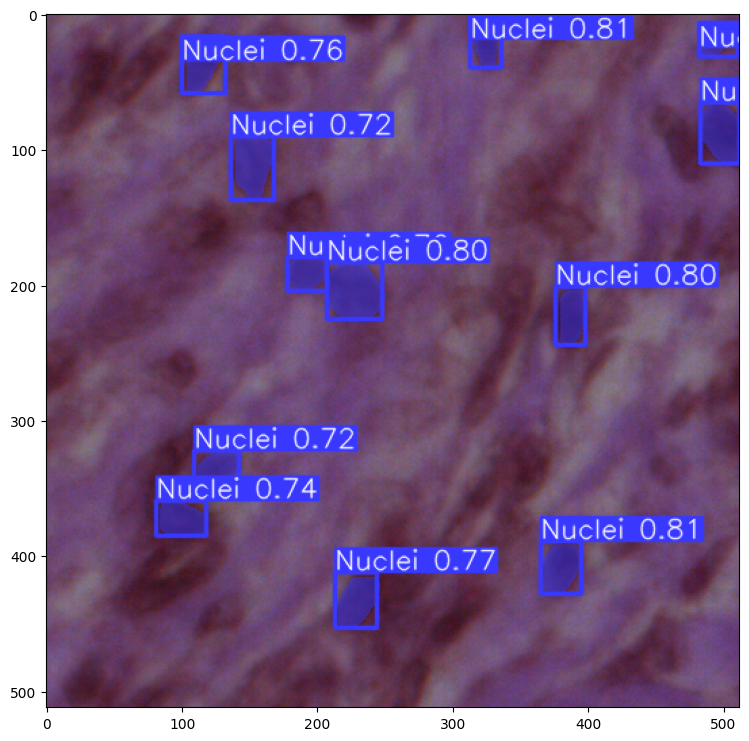

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_peritoneum_3.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_placenta_27.png: 512x512 31 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 9.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


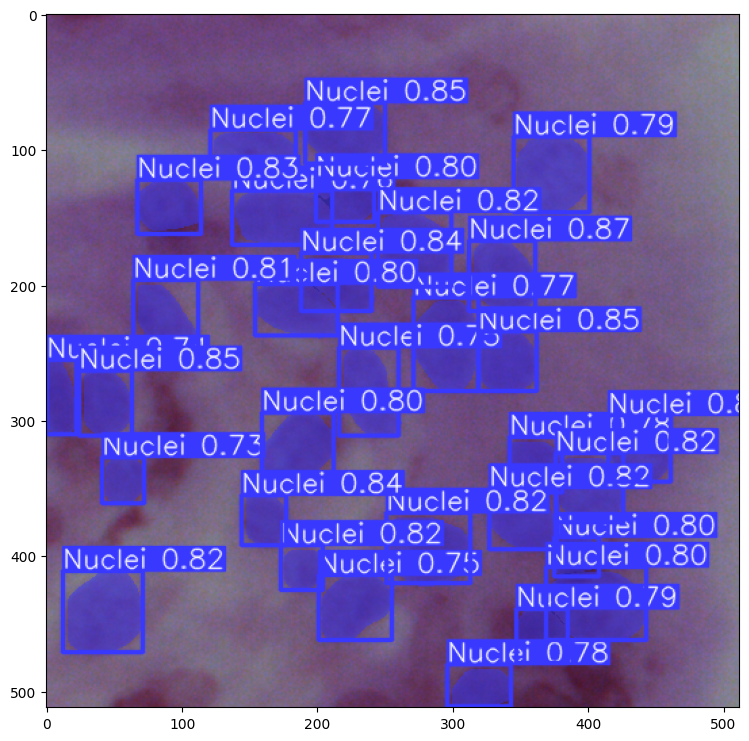

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_placenta_27.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_pylorus_7.png: 512x512 11 Nucleis, 83.1ms
Speed: 1.6ms preprocess, 83.1ms inference, 7.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


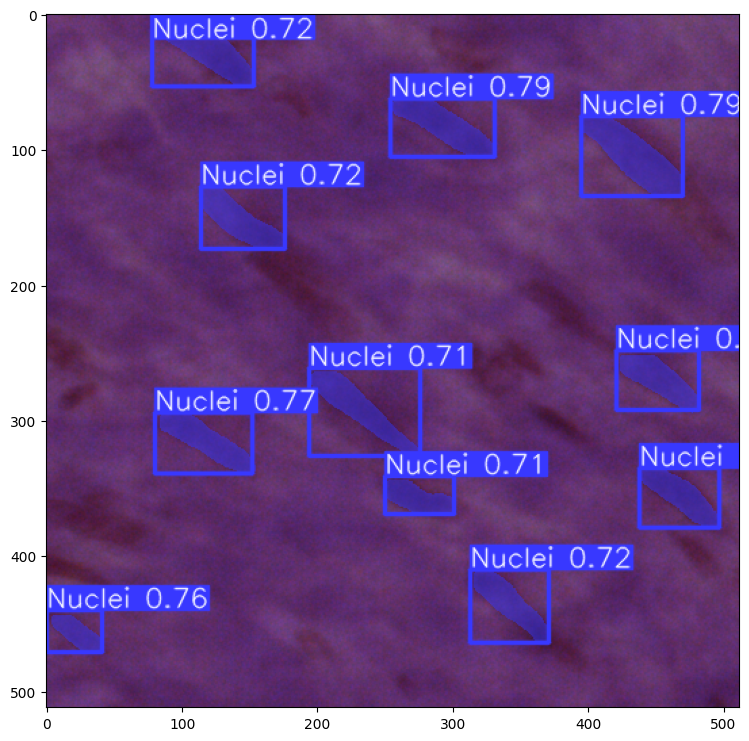

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_pylorus_7.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_salivory_19.png: 512x512 34 Nucleis, 87.2ms
Speed: 3.6ms preprocess, 87.2ms inference, 11.9ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


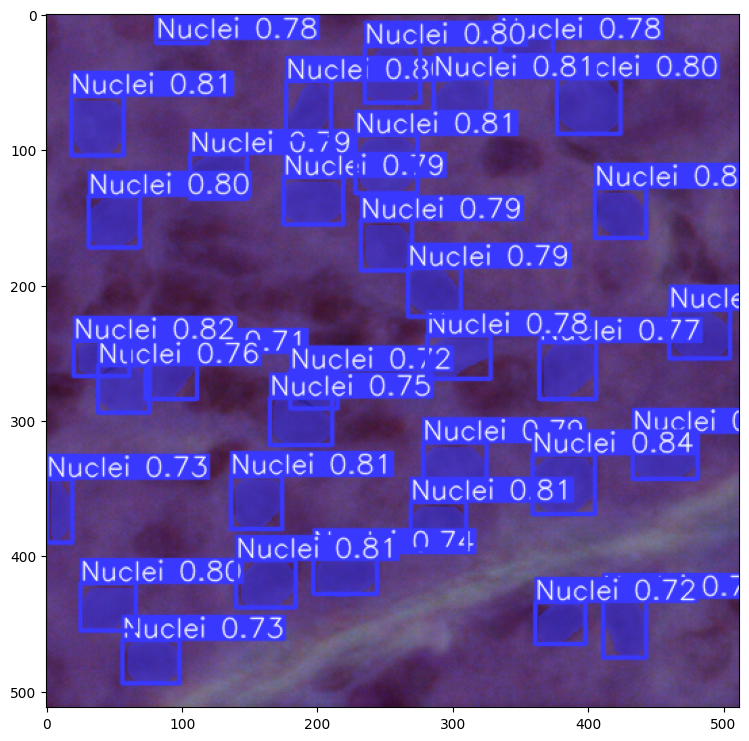

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_salivory_19.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_spleen_06.png: 512x512 13 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 6.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


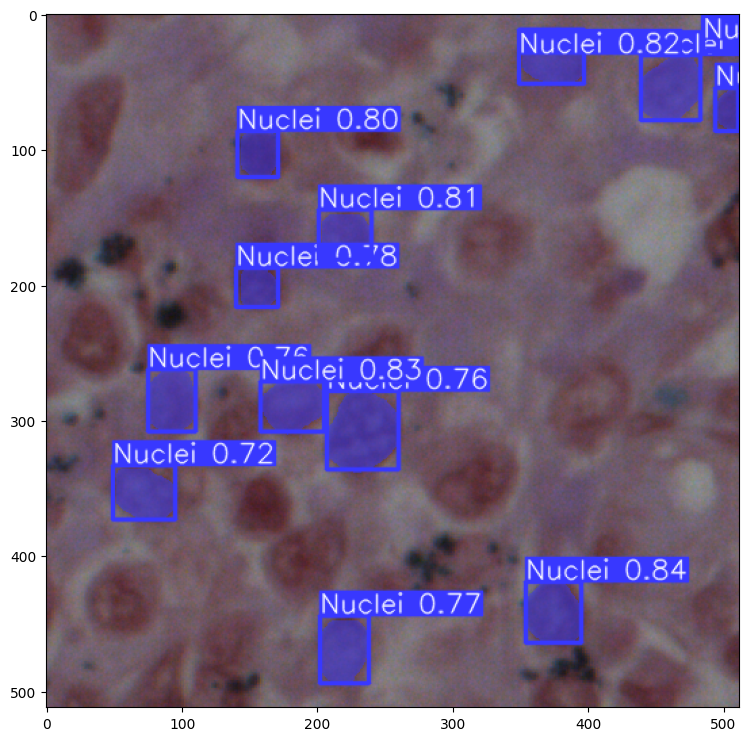

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_spleen_06.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_peritoneum_3.png: 512x512 12 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 5.6ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


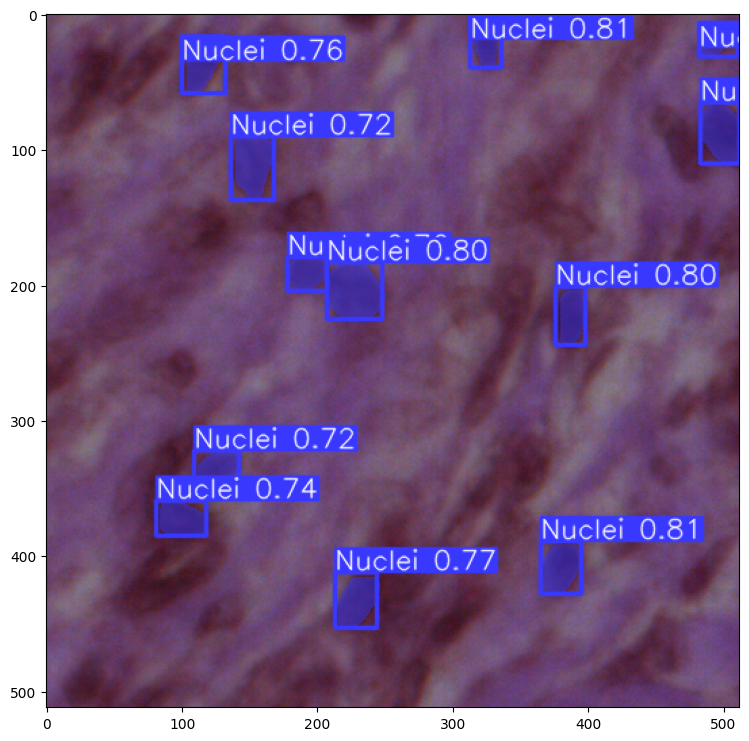

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_peritoneum_3.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_tongue_31.png: 512x512 4 Nucleis, 88.9ms
Speed: 1.5ms preprocess, 88.9ms inference, 3.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


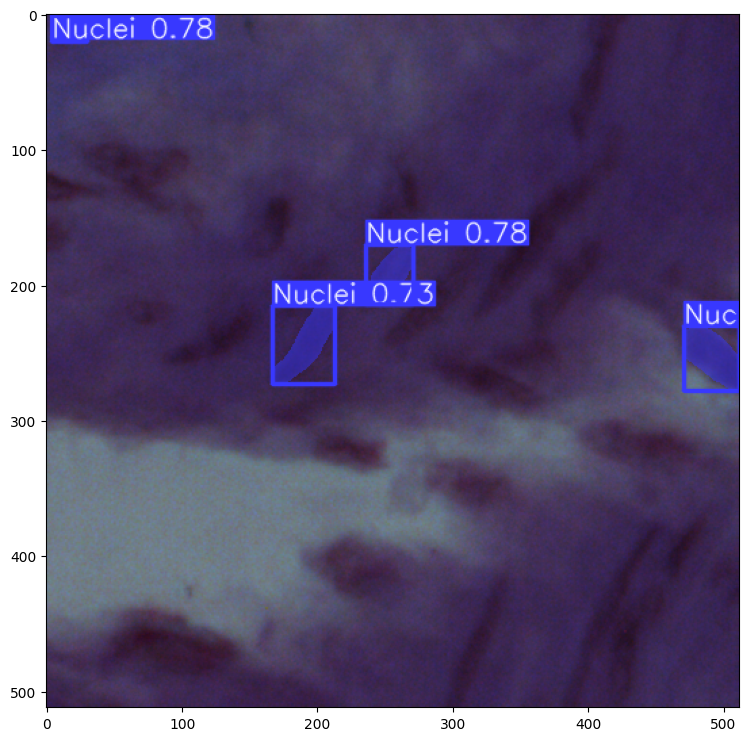

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_tongue_31.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/human_umbilical_cord_02.png: 512x512 1 Nuclei, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 5.2ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


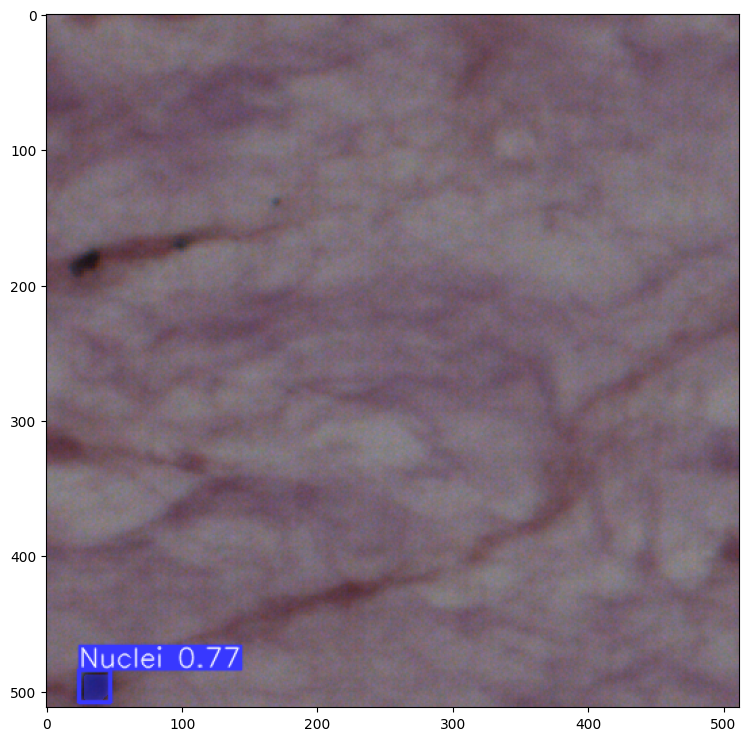

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/human_umbilical_cord_02.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_femur_01.png: 512x512 2 Nucleis, 79.5ms
Speed: 1.3ms preprocess, 79.5ms inference, 3.4ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


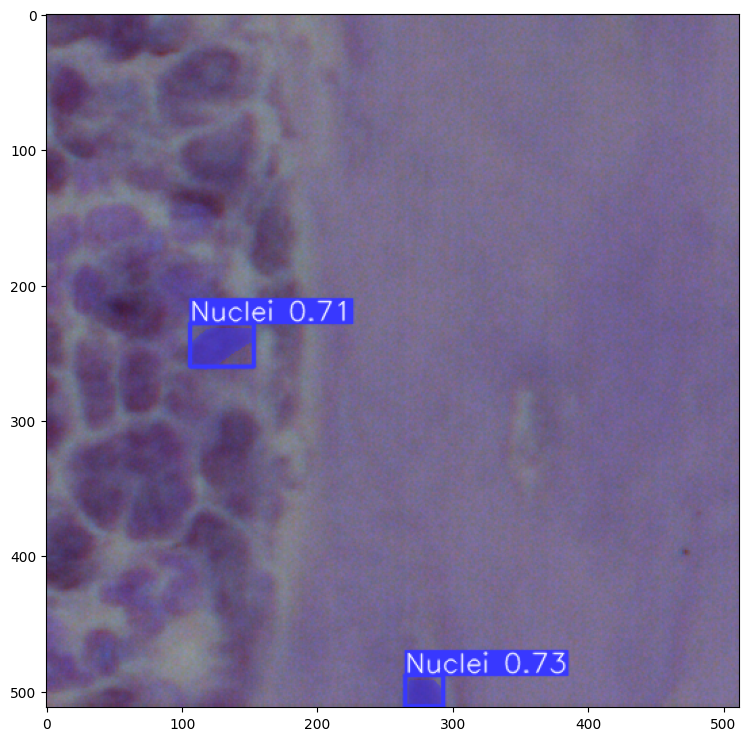

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_femur_01.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_heart_21.png: 512x512 1 Nuclei, 79.5ms
Speed: 1.5ms preprocess, 79.5ms inference, 3.5ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


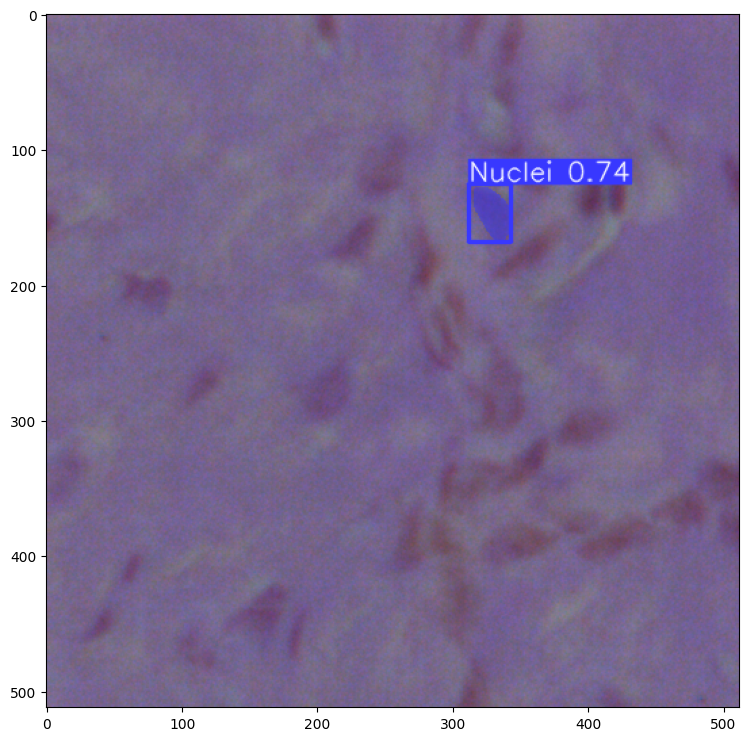

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_heart_21.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_kidney_20.png: 512x512 20 Nucleis, 83.7ms
Speed: 1.4ms preprocess, 83.7ms inference, 8.3ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


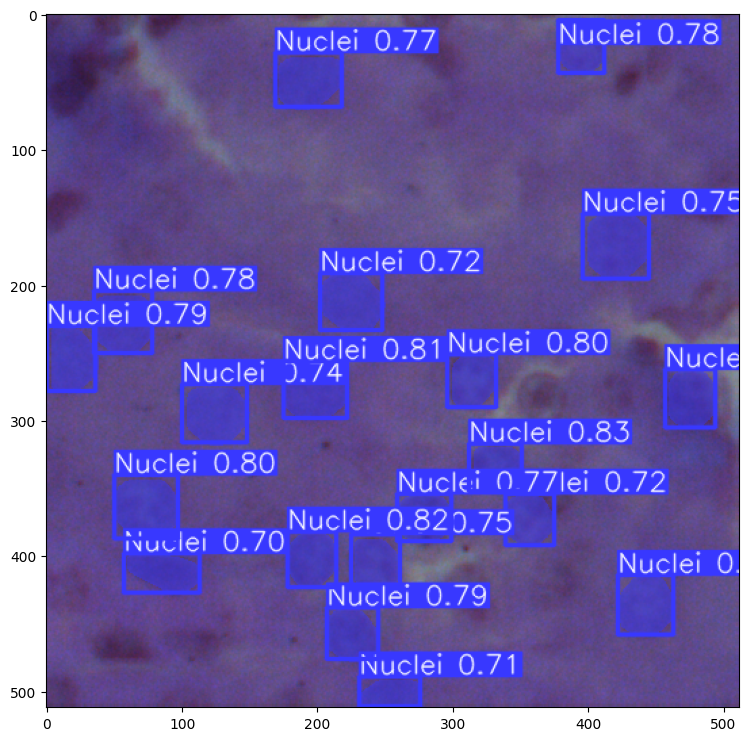

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_kidney_20.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_liver_09.png: 512x512 1 Nuclei, 82.7ms
Speed: 1.4ms preprocess, 82.7ms inference, 4.8ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


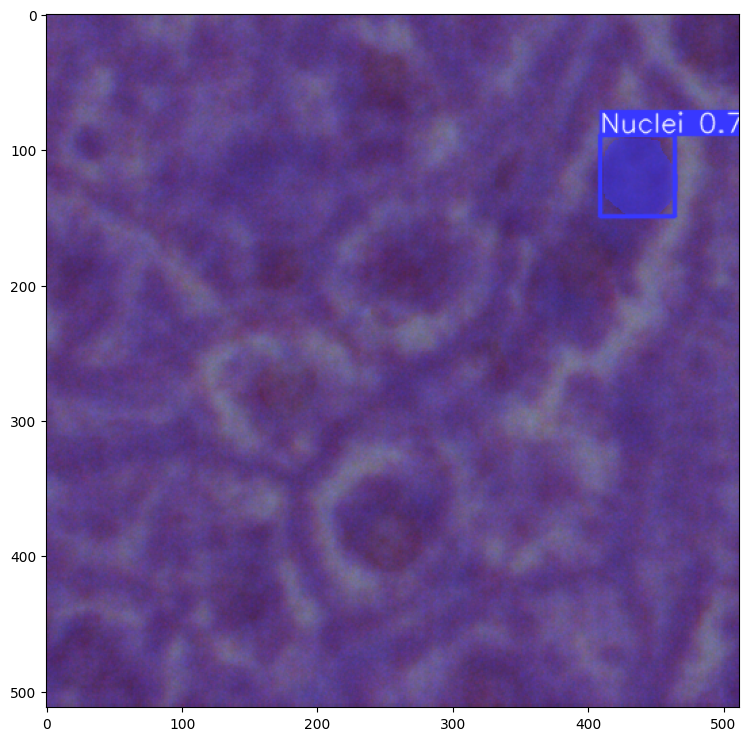

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_liver_09.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_muscle_tibia_11.png: 512x512 3 Nucleis, 79.5ms
Speed: 1.4ms preprocess, 79.5ms inference, 6.9ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


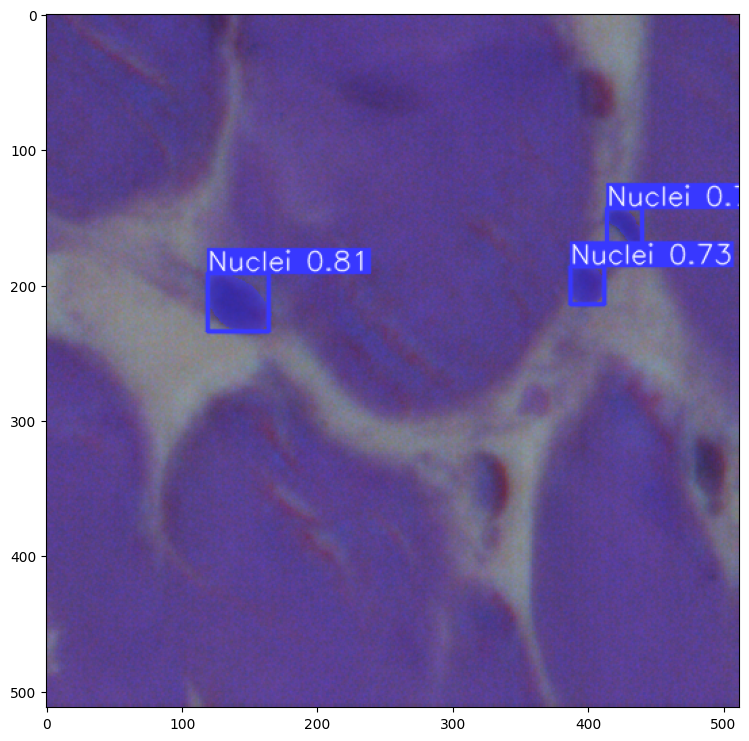

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_muscle_tibia_11.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_spleen_07.png: 512x512 57 Nucleis, 90.0ms
Speed: 1.5ms preprocess, 90.0ms inference, 19.0ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


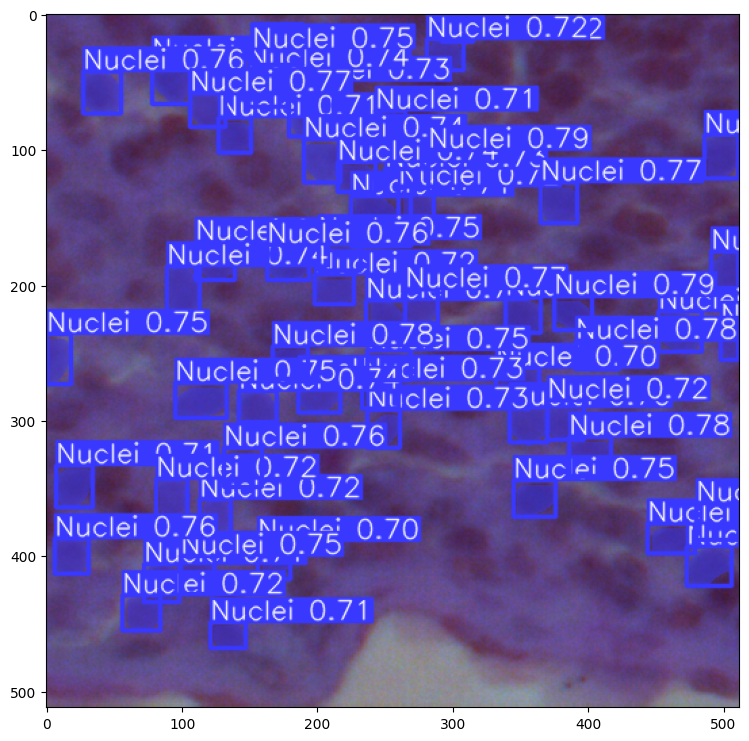

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_spleen_07.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_subscapula_41.png: 512x512 1 Nuclei, 219.1ms
Speed: 2.9ms preprocess, 219.1ms inference, 13.3ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


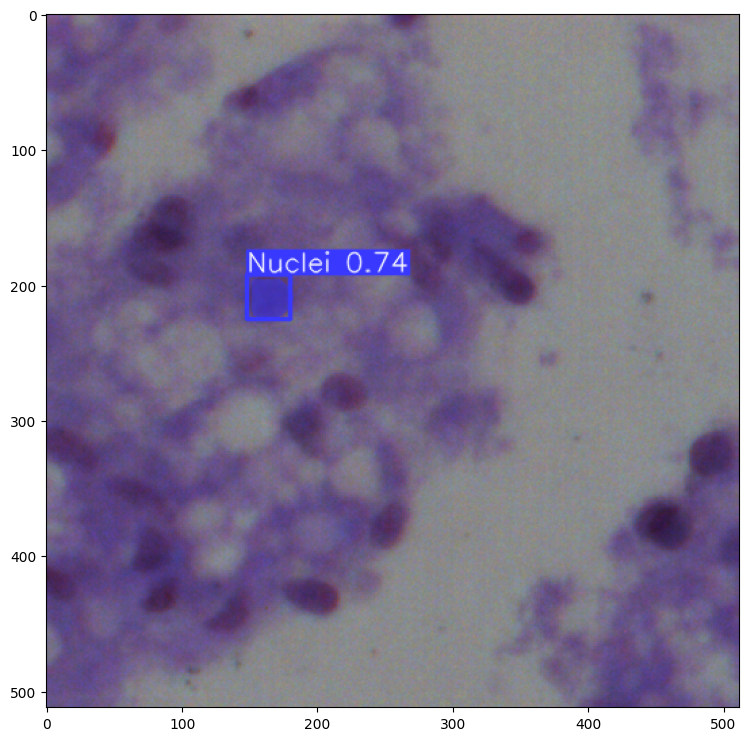

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_subscapula_41.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()


image 1/1 /content/yolov9e_1024_dataset/val/images/mouse_thymus_01.png: 512x512 58 Nucleis, 91.4ms
Speed: 1.5ms preprocess, 91.4ms inference, 15.7ms postprocess per image at shape (1, 3, 512, 512)
Results saved to runs/segment/predict


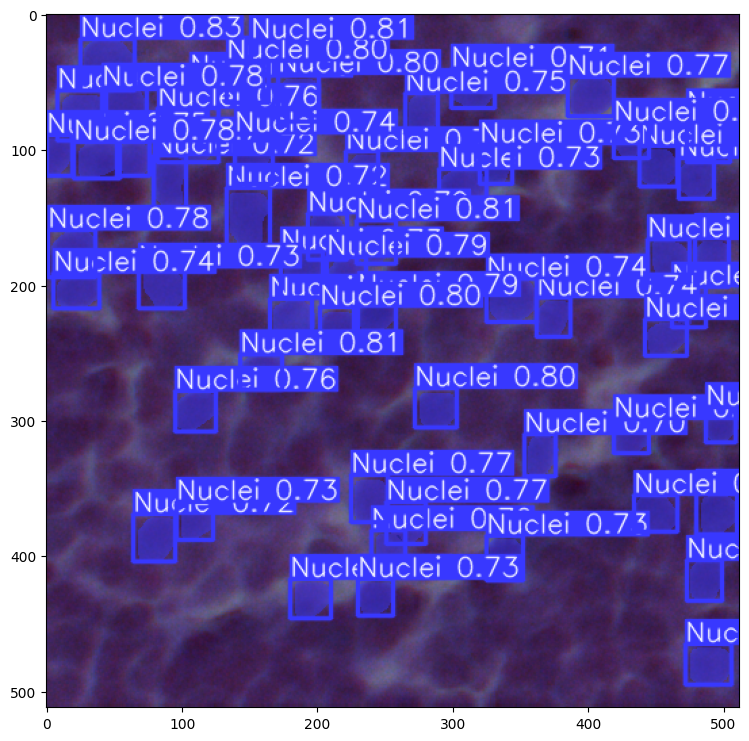

In [ ]:
inference_img_path = "yolov9e_1024_dataset/val/images/mouse_thymus_01.png"
inference_result = inference_model.predict(inference_img_path,conf=0.7,visualize=False,save=True)

inference_result_array = inference_result[0].plot()
plt.figure(figsize=(9,9))
plt.imshow(inference_result_array)
plt.show()